# 2.4 Analyses of patterns per trial type

In [17]:

""" 
IMPORTS
"""
import os
import autograd.numpy as np
import pickle
import seaborn as sns
from collections import defaultdict
import pandas as pd
from matplotlib import colors as mcolors
from one.api import ONE
from pprint import pprint
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, Normalizer
import collections

# Get my functions
functions_path =  '/home/ines/repositories/representation_learning_variability/Models/Sub-trial//2_fit_models/'
# functions_path = '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability//Models/Sub-trial//2_fit_models/'
os.chdir(functions_path)
from preprocessing_functions import concatenate_sessions, fix_discontinuities
functions_path =  '/home/ines/repositories/representation_learning_variability/Models/Sub-trial//3_postprocess_results/'
# functions_path = '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability//Models/Sub-trial//2_fit_models/'
os.chdir(functions_path)
from postprocessing_functions import remove_states_str, state_identifiability
from plotting_functions import align_bin_design_matrix, states_per_trial_phase, broader_label, traces_over_few_sates

# one = ONE(base_url='https://alyx.internationalbrainlab.org')
one = ONE(mode='remote')

## Parameters

In [18]:
bin_size = 0.1
multiplier = 1/bin_size

event_type_list = ['goCueTrigger_times']  # , 'feedback_times', 'firstMovement_times'
event_type_name = ['Go cue']  # , 'Feedback time', 'First movement onset'

num_train_batches = 5
threshold = 0.05
sticky = False

# Values for grid search (should get this from results)
last_lag = 20
lag_step = 2
start_lag = 1
Lags = list(range(start_lag, last_lag, lag_step))
kappas = [0, 1, 5, 10, 100, 500, 1000, 2000, 5000, 7000, 10000]


## Get data

In [19]:
# Load preprocessed data
prepro_results_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Results/' + str(bin_size) + '/'
os.chdir(prepro_results_path)
idxs, mouse_names, matrix_all, matrix_all_unnorm, session_all = pickle.load(open(prepro_results_path + "preprocessed_data_v4_170724", "rb"))
collapsed_matrices, collapsed_unnorm, collapsed_trials = concatenate_sessions (mouse_names, matrix_all, matrix_all_unnorm, session_all)

## Plot combined states per animal

In [20]:
use_sets = [['avg_wheel_vel'], ['Lick count'], ['whisker_me'],
            ['left_X', 'left_Y', 'right_X', 'right_Y'], ['nose_X', 'nose_Y']]
use_sets = [['avg_wheel_vel'], ['Lick count'], ['whisker_me'],
            ['left_X', 'left_Y', 'right_X', 'right_Y']]
use_sets = [['avg_wheel_vel'], ['Lick count'], ['whisker_me']]
var_interest_map = ['avg_wheel_vel', 'Lick count', 'whisker_me', 'left_X', 'nose_X']
idx_init_list = [0, 1, 2, 3, 7]
idx_end_list = [1, 2, 3, 7, 9]

## Plot concatenated sessions

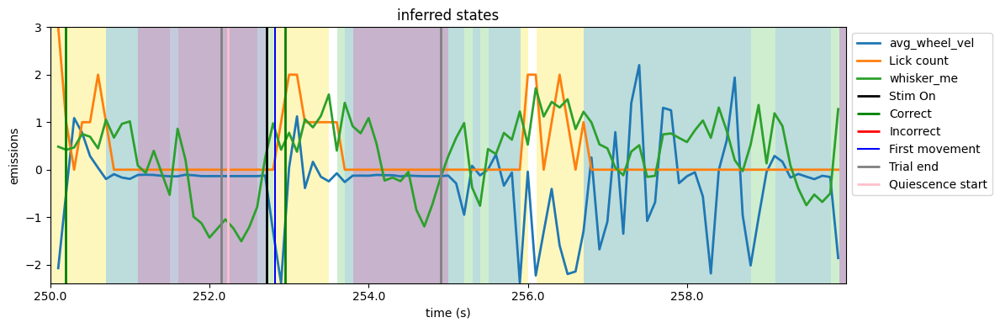

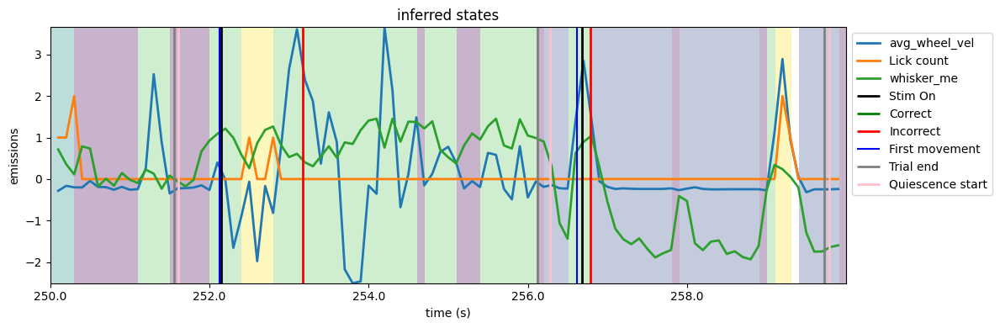

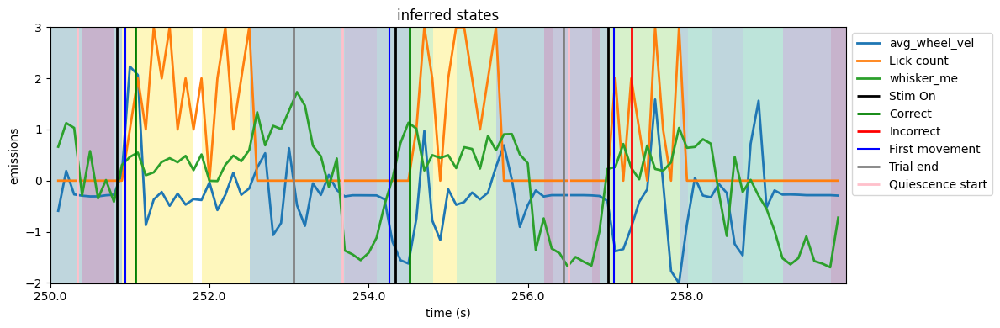

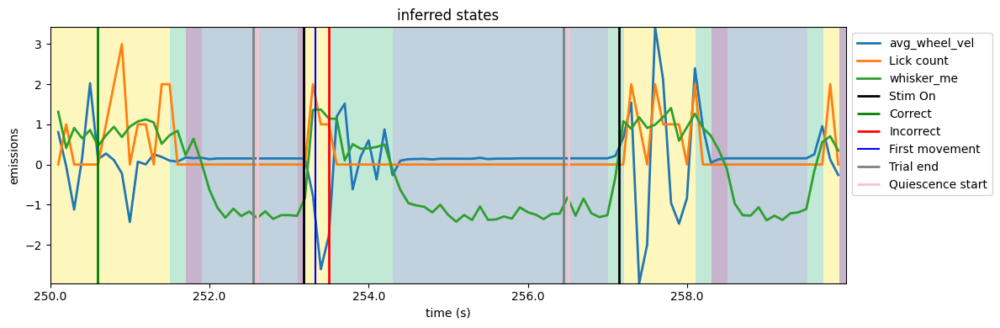

CSHL052


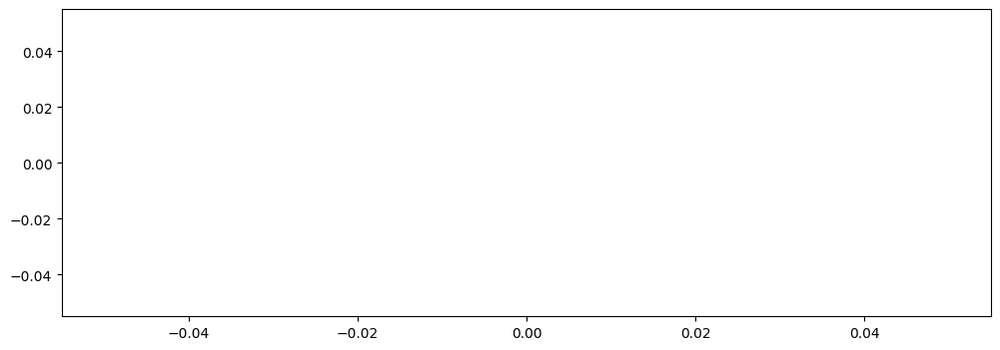

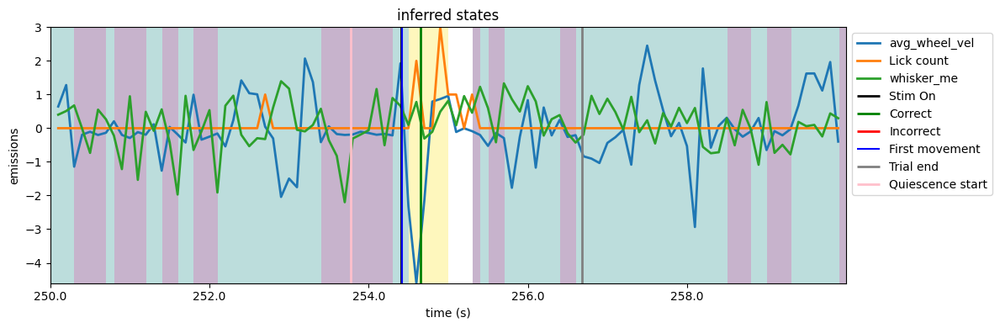

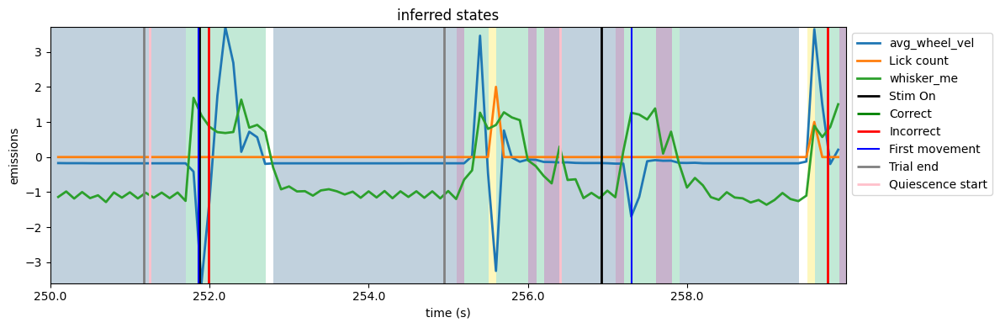

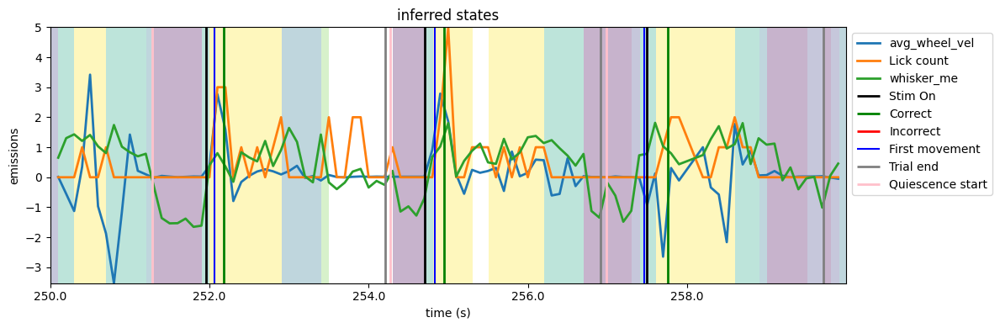

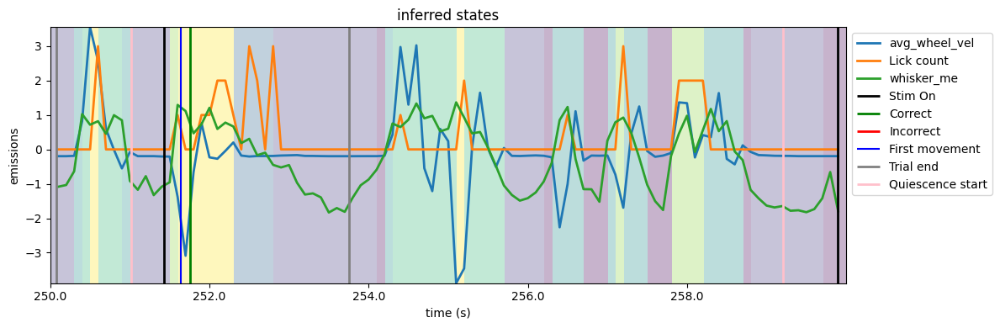

...

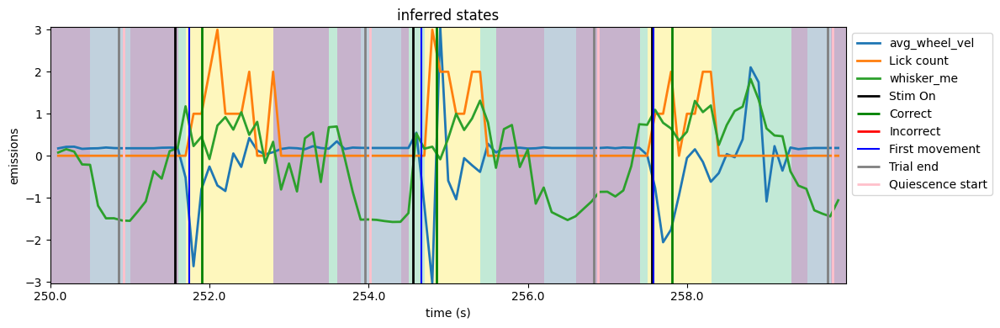

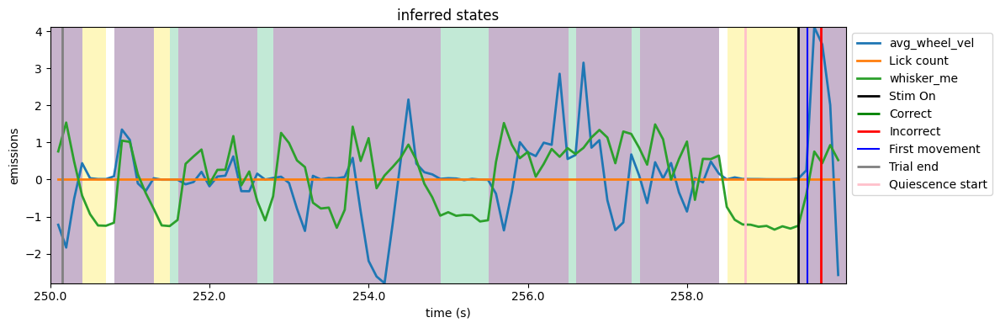

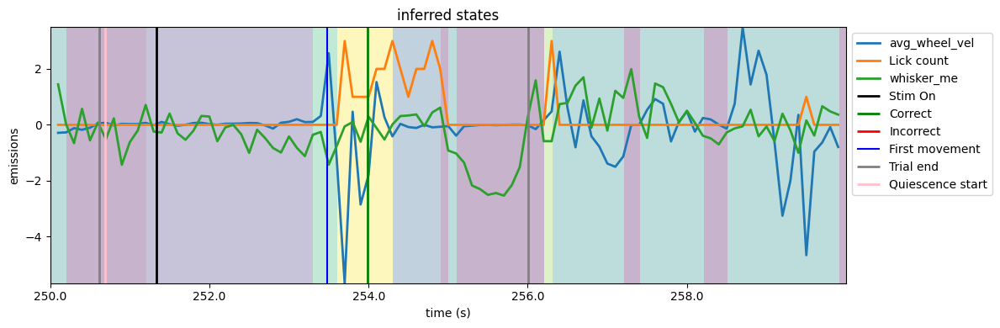

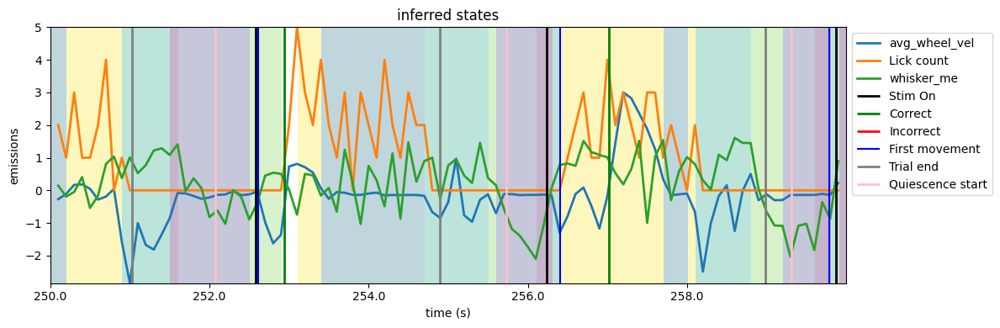

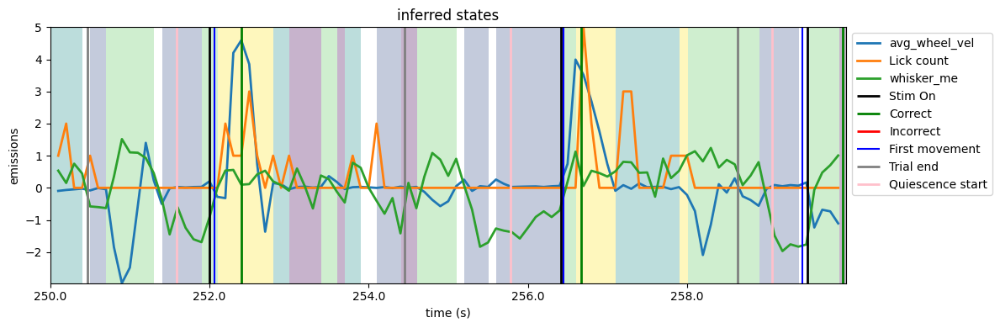

In [7]:
# Loop through animals

for m, mouse_name in enumerate(np.unique(mouse_names)):
    
    try:
        # mouse_name = 'CSHL051'
        var_names = ['avg_wheel_vel', 'Lick count', 'whisker_me']
        
        # Get mouse data
        session_trials = collapsed_trials[mouse_name].copy()
        design_matrix = collapsed_matrices[mouse_name][:,0:3].copy()  # TODO: find a way for this not to be hardcoded
        unnorm_mat = collapsed_unnorm[mouse_name][var_names].copy()
        unnorm_mat['Bin'] = collapsed_unnorm[mouse_name]['Bin'].copy()
            
        # Get states per variable and concatenate
        states_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Results/' + str(bin_size) + '/most_likely_states/'
        os.chdir(states_path)

        c_states = []
        for s, set in enumerate(use_sets):
            
            most_likely_states, _ = pickle.load(open("most_likely_states" + set[0] + '_' + mouse_name, "rb"))
            # Save
            if len(c_states) == 0:
                c_states = most_likely_states
            else:
                c_states = np.vstack((c_states, most_likely_states))      
        
        combined_states = remove_states_str(c_states.T, threshold)
            
        # Change states back to integer
        state_labels = np.unique(combined_states)
        int_state = np.arange(0, len(state_labels), 1).astype(float)
        if state_labels[-1] == 'nan':
            int_state[-1] = np.nan
        # Define the mapping as a dictionary
        mapping = {unique: key for unique, key in zip(state_labels, int_state)}

        # Use np.vectorize to apply the mapping
        replace_func = np.vectorize(mapping.get)
        new_states = replace_func(combined_states)

        " Plots "
        # Prepare data 
        num_timesteps = np.shape(design_matrix)[0]
        num_states = len(np.unique(new_states))
        
        # Prepare data
        design_matrix_heading = pd.DataFrame(columns=var_names)
        design_matrix_heading[var_names] = design_matrix[0:len(new_states)]  # TODO: need to understand why number is the same and whether it depends on lag
        bins = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Bin']
        design_matrix_heading['Bin'] = bins
        design_matrix_heading['Lick count'] = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Lick count']
        # Fix discontinuities
        cont_trials, cont_design_matrix_heading = fix_discontinuities(session_trials, design_matrix_heading, multiplier)
        
        # Align bins
        init = -1 * multiplier
        end = 1.5 * multiplier
        empirical_data = align_bin_design_matrix(init, end, event_type_list, cont_trials, cont_design_matrix_heading, new_states, multiplier)


        # """ Stack trial states """
        # trial_init = 30  # First trial to plot
        # trials_to_plot = 20  # How many trials to plot (if very different will compromise readibility)
        # plot_states_aligned_trial(trial_init, empirical_data, cont_trials, bin_size, trials_to_plot, num_states)

        # " Plot states stacked and aligned per trial type "
        # # event_type_name = ['Feedback time']
        # plot_states_aligned(init, end, empirical_data, event_type_name, bin_size)
        
        # """ Plot states per trial epoch """
        # colors = sns.color_palette("viridis", num_states)
        # states_trial = states_per_trial_phase(empirical_data, cont_trials, multiplier)
        # plt.figure(figsize=[7, 5])
        # sns.histplot(x='label', hue=0, data=states_trial, stat = 'percent',
        #                     multiple="stack", legend=True, palette='viridis', alpha=0.3)  # stat='frequency',
        # plt.xlabel('Trial phase')
        # plt.legend(loc='upper left', bbox_to_anchor=(1, -0.5))
        # plt.xticks(rotation=45)
        # plt.tight_layout()
        # plt.title(mouse_name)
        # plt.show()
        
        """ Plot raw traces over states """
        init = 250 * multiplier # First bin
        inter = 10 * multiplier
        traces_over_few_sates(init, inter, empirical_data, cont_trials, var_names, multiplier)
        # traces_over_sates(init, inter, empirical_data, cont_trials)
    
    except:
        print(mouse_name)

## Plot individual sessions

In [21]:
exclude_sessions = ['f1db6257-85ef-4385-b415-2d078ec75df2',
'259927fd-7563-4b03-bc5d-17b4d0fa7a55',
'e49d8ee7-24b9-416a-9d04-9be33b655f40',
'6f6d2c8e-28be-49f4-ae4d-06be2d3148c1',
'193fe7a8-4eb5-4f3e-815a-0c45864ddd77',
'f8d5c8b0-b931-4151-b86c-c471e2e80e5d',
'ebc9392c-1ecb-4b4b-a545-4e3d70d23611',
'537677fe-1e24-4755-948c-fa4a4e8ecce5',
'a4747ac8-6a75-444f-b99b-696fff0243fd',
'7be8fec4-406b-4e74-8548-d2885dcc3d5e',
'a71175be-d1fd-47a3-aa93-b830ea3634a1',
'53738f95-bd08-4d9d-9133-483fdb19e8da',
'd901aff5-2250-467a-b4a1-0cb9729df9e2',
'7939711b-8b4d-4251-b698-b97c1eaa846e',
'510b1a50-825d-44ce-86f6-9678f5396e02',
'aad23144-0e52-4eac-80c5-c4ee2decb198',
'd839491f-55d8-4cbe-a298-7839208ba12b',
'72cb5550-43b4-4ef0-add5-e4adfdfb5e02']

In [6]:
states_trial_type = pd.DataFrame(columns=['mouse_name', 'session', 'correct', 'choice', 'contrast', 
                                          'reaction', 'response', 'elongation', 'most_likely_states', 
                                          'identifiable_states', 'Bin', 'label'])
for m, mat in enumerate(idxs):
    if len(mat) > 35: 
        # try:
        mouse_name = mat[37:]
        session = mat[0:36]
        
        if session not in exclude_sessions:
            var_names = ['avg_wheel_vel', 'Lick count', 'whisker_me']

            # Get mouse data          
            session_trials = session_all[mouse_name][session]
            design_matrix = matrix_all[mouse_name][session][:,0:3]
            unnorm_mat = matrix_all_unnorm[mouse_name][session][var_names]
            unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']

            # Get states per variable and concatenate
            states_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Results/' + str(bin_size) + '/most_likely_states/'
            os.chdir(states_path)

            c_states = []
            for s, set in enumerate(use_sets):
                
                most_likely_states, _ = pickle.load(open("most_likely_states" + set[0] + '_' + mouse_name + session, "rb"))
                # Save
                if len(c_states) == 0:
                    c_states = most_likely_states
                else:
                    c_states = np.vstack((c_states, most_likely_states))      
            
            combined_states = remove_states_str(c_states.T, threshold)
            
            " Prepare data "
            num_timesteps = np.shape(design_matrix)[0]
            design_matrix_heading = pd.DataFrame(columns=var_names)
            design_matrix_heading[var_names] = design_matrix[0:len(combined_states)]  # TODO: need to understand why number is the same and whether it depends on lag
            bins = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Bin']
            design_matrix_heading['Bin'] = bins
            design_matrix_heading['Lick count'] = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Lick count']
            
            # Transform states into identifiable states
            identifiable_states = state_identifiability(combined_states, design_matrix_heading)
            
            # Change states back to integer
            state_labels = np.unique(identifiable_states)
            int_state = np.arange(0, len(state_labels), 1).astype(float)
            if state_labels[-1] == 'nan':
                int_state[-1] = np.nan
            # Define the mapping as a dictionary
            mapping = {unique: key for unique, key in zip(state_labels, int_state)}
            inverted_mapping = {v: k for k, v in mapping.items()}

            # Use np.vectorize to apply the mapping
            replace_func = np.vectorize(mapping.get)
            new_states = replace_func(identifiable_states)
            num_states = len(np.unique(new_states))

            # Align bins
            init = -1 * multiplier
            end = 1.5 * multiplier
            empirical_data = align_bin_design_matrix(init, end, event_type_list, session_trials, design_matrix_heading, new_states, multiplier)
            empirical_data['identifiable_states'] = identifiable_states
            
            """ Trial types """
            # Split in trial types
            states_trial = states_per_trial_phase(empirical_data, session_trials, multiplier)
            states_trial['mouse_name'] = mouse_name
            states_trial['session'] = session
            replace_func = np.vectorize(inverted_mapping.get)
            str_states = replace_func(np.array(states_trial['most_likely_states']))
            states_trial['identifiable_states'] = str_states
            states_trial = broader_label(states_trial)
            
            # Save to big df
            if len(states_trial_type) == 0:
                states_trial_type = states_trial.copy()
            else:
                states_trial_type = states_trial_type.append(states_trial)
                
            vars = ['mouse_name', 'session', 'contrast', 'time_bin', 'broader_label', 'correct']
            use_data = states_trial.loc[states_trial_type['elongation']<=5]
            use_data['time_bin'] = pd.cut(use_data['elongation'], 10)
            count = groupby(vars, use_data)
        else:
            print(session)


/tmp/ipykernel_15261/4012505072.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat

72cb5550-43b4-4ef0-add5-e4adfdfb5e02


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

d839491f-55d8-4cbe-a298-7839208ba12b


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

aad23144-0e52-4eac-80c5-c4ee2decb198


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

510b1a50-825d-44ce-86f6-9678f5396e02


/tmp/ipykernel_15261/4012505072.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat

7939711b-8b4d-4251-b698-b97c1eaa846e


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:237: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  stim_left_states = stim_left_states.append(react_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.ap

d901aff5-2250-467a-b4a1-0cb9729df9e2
53738f95-bd08-4d9d-9133-483fdb19e8da


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

a71175be-d1fd-47a3-aa93-b830ea3634a1


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:230: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  right_states = right_states.append(move_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:240: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  stim_right_states = stim_right_states.append(react_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(qui

7be8fec4-406b-4e74-8548-d2885dcc3d5e


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:237: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  stim_left_states = stim_left_states.append(react_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.ap

a4747ac8-6a75-444f-b99b-696fff0243fd


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

537677fe-1e24-4755-948c-fa4a4e8ecce5


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

ebc9392c-1ecb-4b4b-a545-4e3d70d23611


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

f8d5c8b0-b931-4151-b86c-c471e2e80e5d


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

193fe7a8-4eb5-4f3e-815a-0c45864ddd77


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

6f6d2c8e-28be-49f4-ae4d-06be2d3148c1


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:215: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  incorrect_states =incorrect_states.append(incorrect_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:220: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_incorrect = ITI_stat

e49d8ee7-24b9-416a-9d04-9be33b655f40


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

259927fd-7563-4b03-bc5d-17b4d0fa7a55


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:230: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  right_states = right_states.append(move_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:237: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  stim_left_states = stim_left_states.append(react_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quies

f1db6257-85ef-4385-b415-2d078ec75df2


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:210: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

/tmp/ipykernel_15261/500210812.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

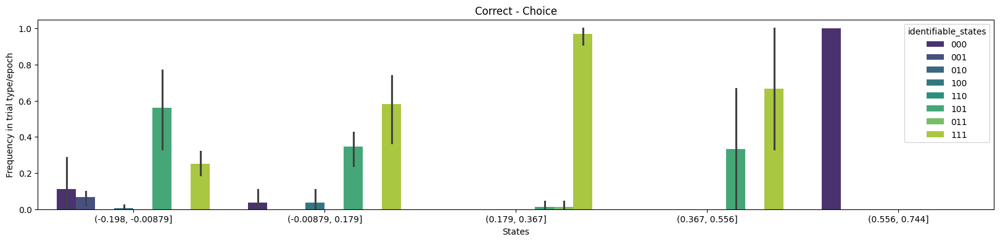

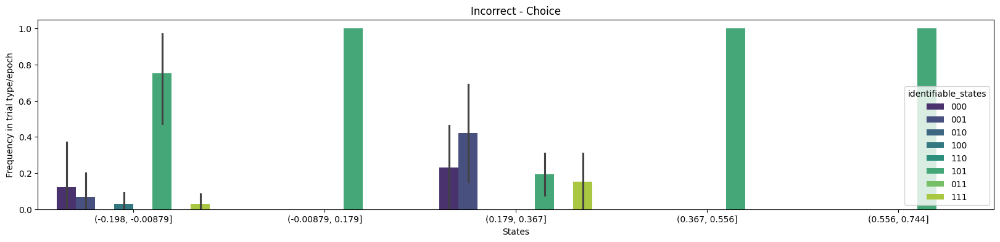

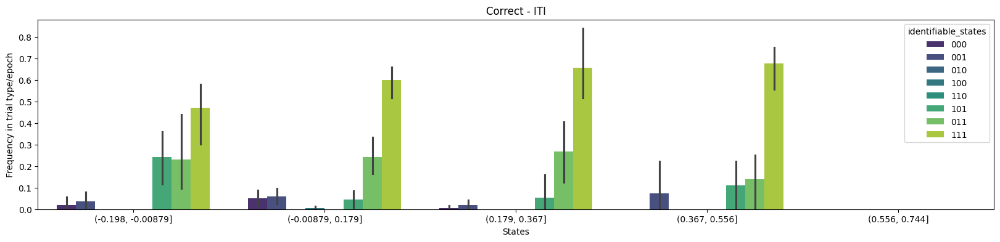

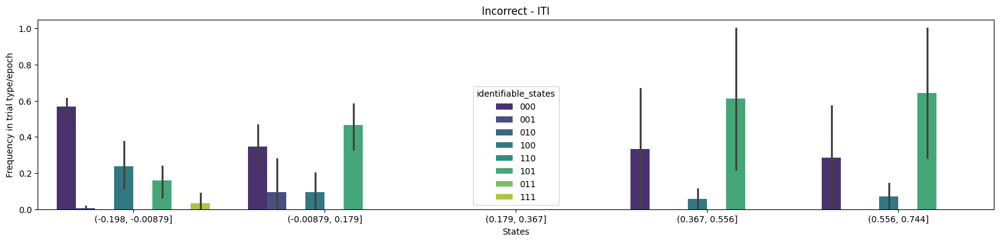

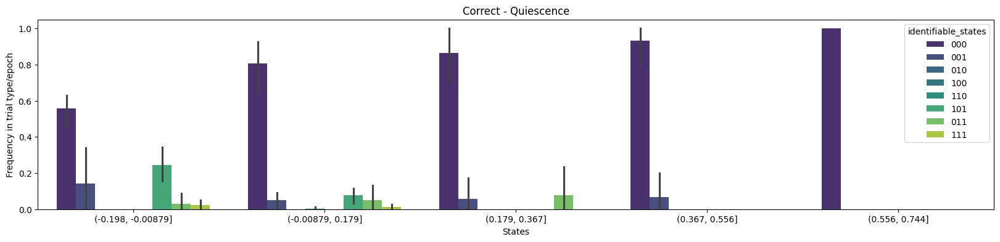

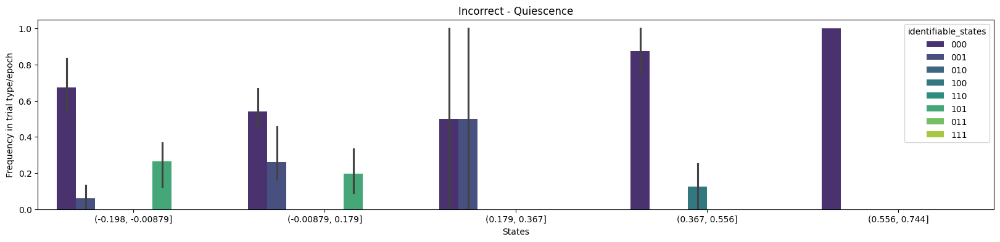

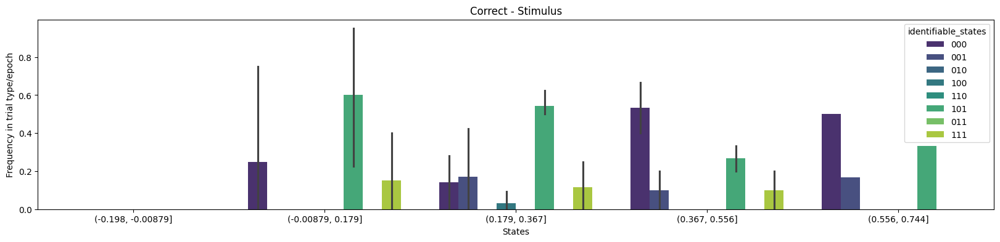

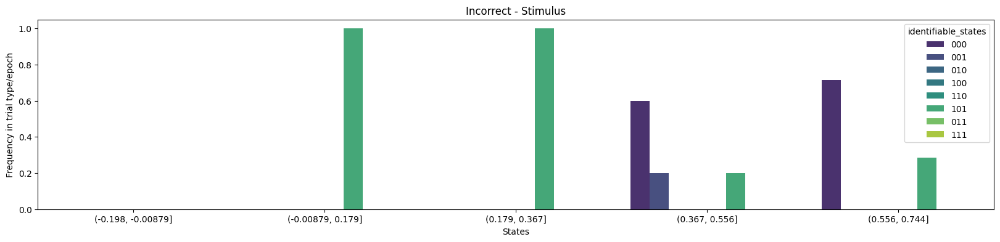

72cb5550-43b4-4ef0-add5-e4adfdfb5e02


/tmp/ipykernel_15261/500210812.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

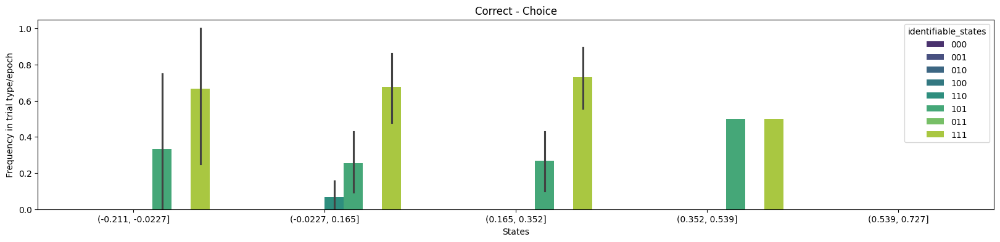

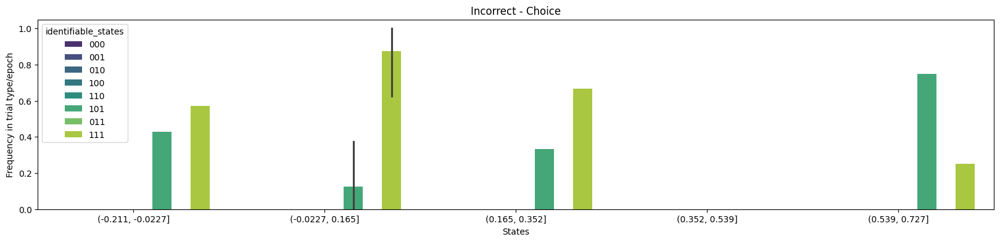

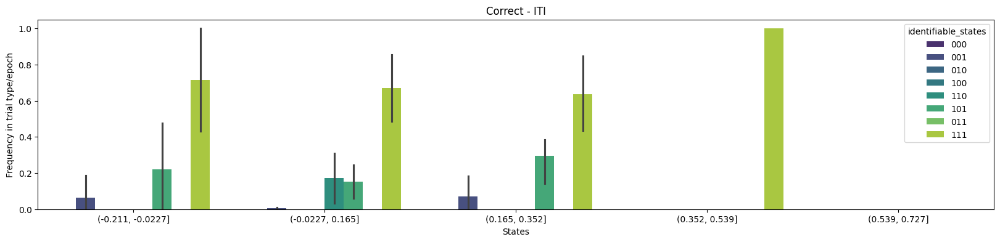

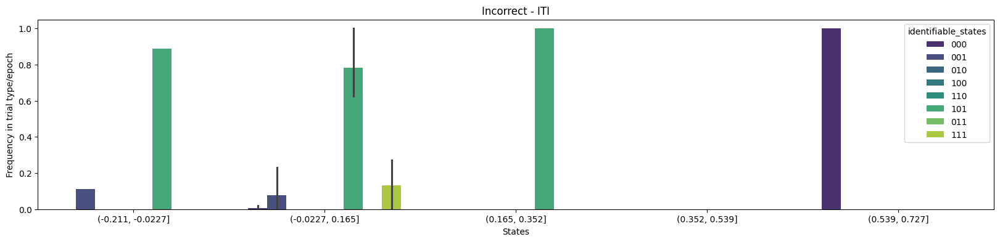

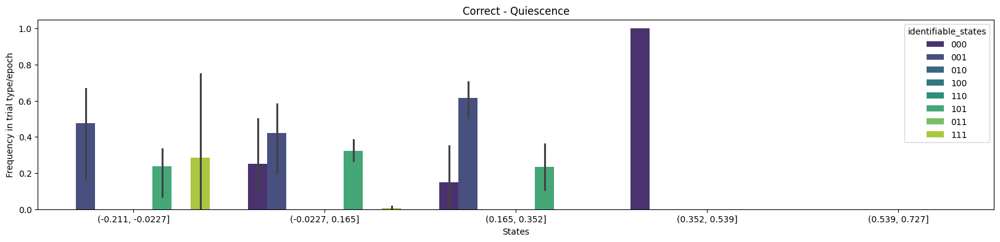

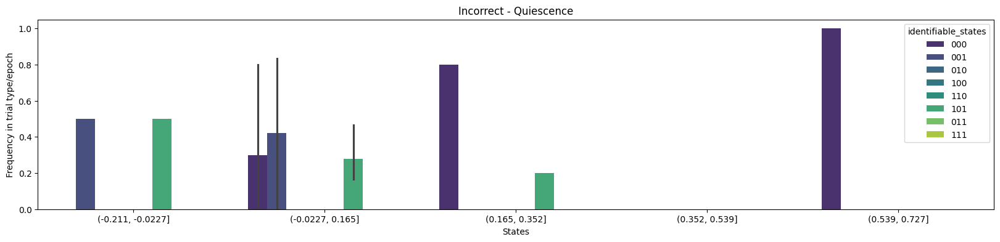

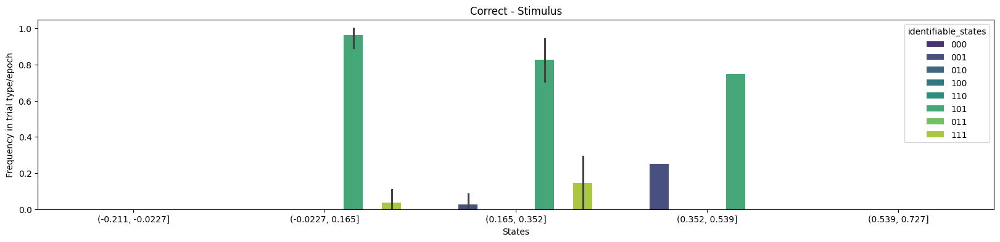

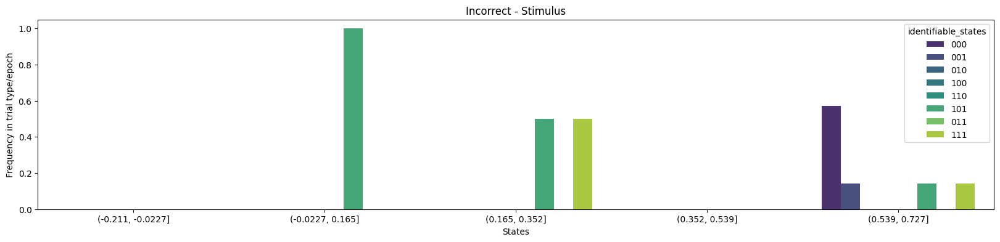

d839491f-55d8-4cbe-a298-7839208ba12b


/tmp/ipykernel_15261/500210812.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

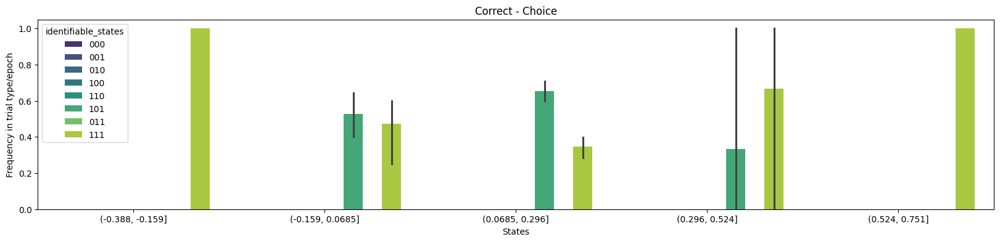

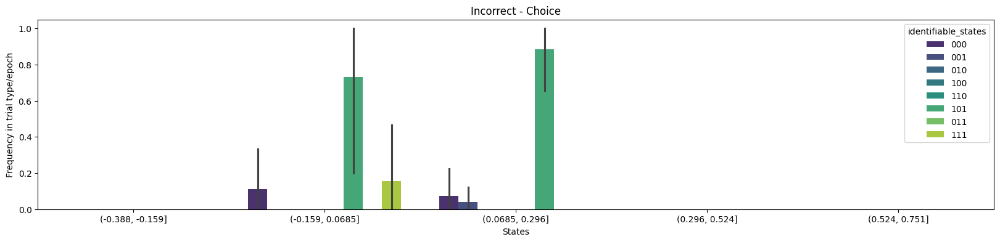

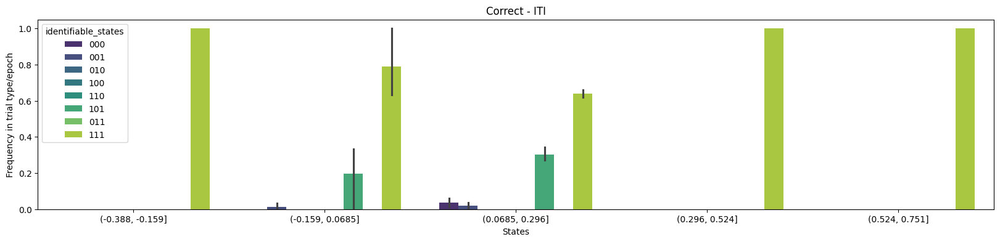

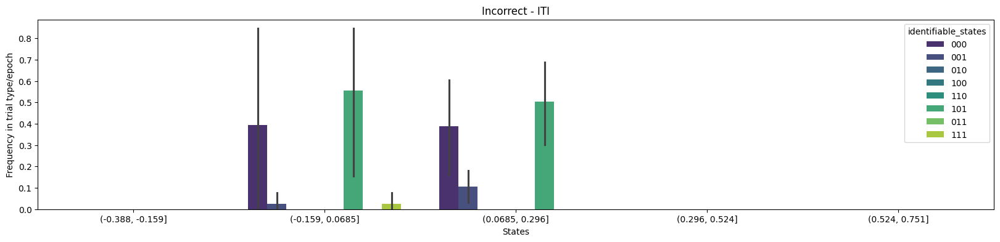

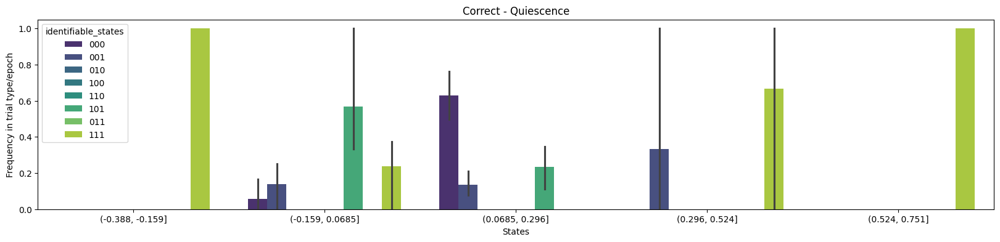

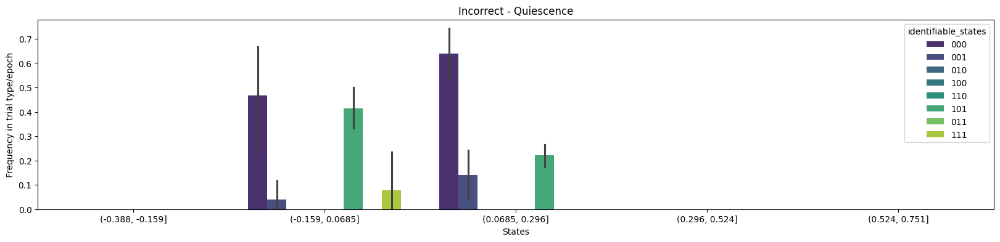

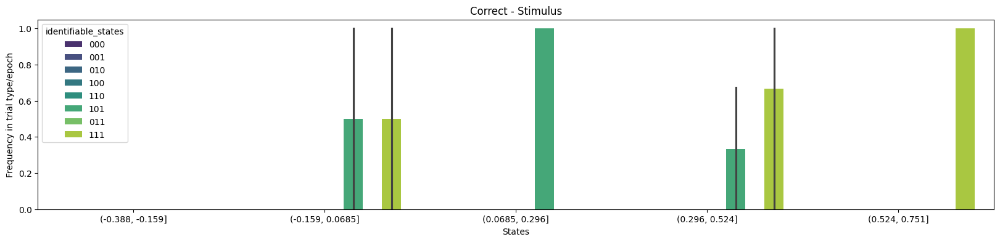

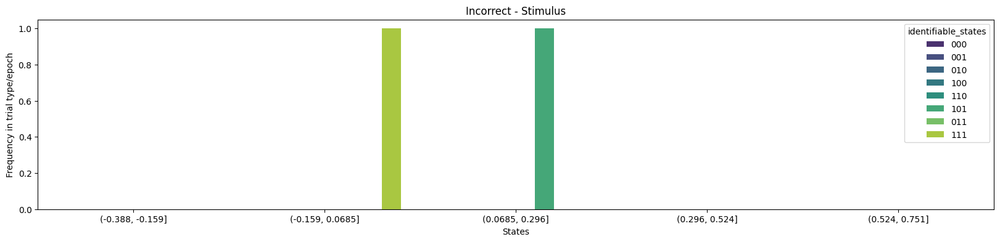

/tmp/ipykernel_15261/500210812.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:198: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:205: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

KeyboardInterrupt: 

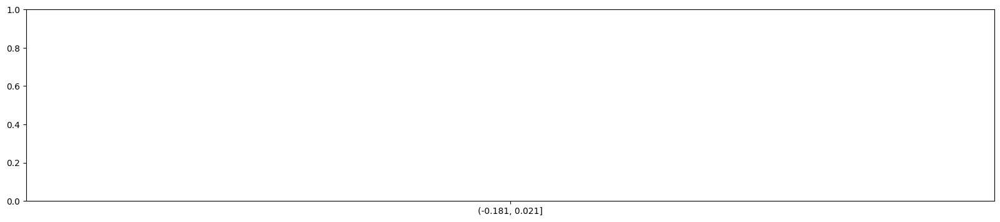

In [138]:
for m, mat in enumerate(idxs):
    if len(mat) > 35: 
        # try:
        mouse_name = mat[37:]
        session = mat[0:36]
        
        if session not in exclude_sessions:
            var_names = ['avg_wheel_vel', 'Lick count', 'whisker_me']

            # Get mouse data          
            session_trials = session_all[mouse_name][session]
            design_matrix = matrix_all[mouse_name][session][:,0:3]
            unnorm_mat = matrix_all_unnorm[mouse_name][session][var_names]
            unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']

            # Get states per variable and concatenate
            states_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Results/' + str(bin_size) + '/most_likely_states/'
            os.chdir(states_path)

            c_states = []
            for s, set in enumerate(use_sets):
                
                most_likely_states, _ = pickle.load(open("most_likely_states" + set[0] + '_' + mouse_name + session, "rb"))
                # Save
                if len(c_states) == 0:
                    c_states = most_likely_states
                else:
                    c_states = np.vstack((c_states, most_likely_states))      
            
            combined_states = remove_states_str(c_states.T, threshold)
            
            " Prepare data "
            num_timesteps = np.shape(design_matrix)[0]
            design_matrix_heading = pd.DataFrame(columns=var_names)
            design_matrix_heading[var_names] = design_matrix[0:len(combined_states)]  # TODO: need to understand why number is the same and whether it depends on lag
            bins = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Bin']
            design_matrix_heading['Bin'] = bins
            design_matrix_heading['Lick count'] = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Lick count']
            
            # Transform states into identifiable states
            identifiable_states = state_identifiability(combined_states, design_matrix_heading)
            
            # Change states back to integer
            state_labels = np.unique(identifiable_states)
            int_state = np.arange(0, len(state_labels), 1).astype(float)
            if state_labels[-1] == 'nan':
                int_state[-1] = np.nan
            # Define the mapping as a dictionary
            mapping = {unique: key for unique, key in zip(state_labels, int_state)}
            inverted_mapping = {v: k for k, v in mapping.items()}

            # Use np.vectorize to apply the mapping
            replace_func = np.vectorize(mapping.get)
            new_states = replace_func(identifiable_states)
            num_states = len(np.unique(new_states))

            # Align bins
            init = -1 * multiplier
            end = 1.5 * multiplier
            empirical_data = align_bin_design_matrix(init, end, event_type_list, session_trials, design_matrix_heading, new_states, multiplier)
            empirical_data['identifiable_states'] = identifiable_states
            
            """ Trial types """
            # Split in trial types
            states_trial = states_per_trial_phase(empirical_data, session_trials, multiplier)
            states_trial['mouse_name'] = mouse_name
            states_trial['session'] = session
            replace_func = np.vectorize(inverted_mapping.get)
            str_states = replace_func(np.array(states_trial['most_likely_states']))
            states_trial['identifiable_states'] = str_states
            states_trial = broader_label(states_trial)
            
            """ Plot  """
            vars = ['contrast', 'time_bin', 'broader_label', 'correct']
            extended_vars = ['contrast', 'time_bin', 'broader_label', 'correct', 'identifiable_states']
            use_data = states_trial.loc[states_trial['reaction']<=1]
            use_data['time_bin'] = pd.cut(use_data['reaction'], 5)
            count = groupby(extended_vars, use_data)
            plot_states_binned(count)
            
        else:
            print(session)


In [134]:
list(np.arange(0, len(vars)-1, 1))

[0, 1, 2, 3]

In [135]:
    # Step 1: Group and count occurrences
    vars=extended_vars
    count = pd.DataFrame(use_data.groupby(vars)['identifiable_states'].count())  #  'correct',

    # Step 2: Reset index to bring the grouping columns back into the DataFrame
    count = count.reset_index(level=list(np.arange(0, len(vars)-1, 1)))

    # Rename the count column
    count.rename(columns={'identifiable_states': 'count'}, inplace=True)

    # Step 3: Calculate the total counts for each group of 'mouse_name', 'session', 'label'
    count['total'] = count.groupby(vars[:-1])['count'].transform('sum')  # 'broader_label'

    # Step 4: Compute the relative frequency
    count['relative_frequency'] = count['count'] / count['total']

    # Drop the 'total' column if it's no longer needed
    count = count.drop(columns=['total'])

In [136]:

def groupby(vars, use_data):
    # Step 1: Group and count occurrences
    count = pd.DataFrame(use_data.groupby(vars)['identifiable_states'].count())  #  'correct',

    # Step 2: Reset index to bring the grouping columns back into the DataFrame
    count = count.reset_index(level=list(np.arange(0, len(vars)-1, 1)))

    # Rename the count column
    count.rename(columns={'identifiable_states': 'count'}, inplace=True)

    # Step 3: Calculate the total counts for each group of 'mouse_name', 'session', 'label'
    count['total'] = count.groupby(vars[:-1])['count'].transform('sum')  # 'broader_label'

    # Step 4: Compute the relative frequency
    count['relative_frequency'] = count['count'] / count['total']

    # Drop the 'total' column if it's no longer needed
    count = count.drop(columns=['total'])

    return count


def plot_states_binned(count):
    trial_epoch = np.unique(count['broader_label'])
    epoch ='Quiescence'
    # contrasts = count.contrast.unique()
    use = count.dropna()
    for epoch in trial_epoch:

        data = use.loc[(use['broader_label']==epoch) & (use['correct']==1.)]
        # data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae') & (count['label']=='Quiescence')]
        plt.figure(figsize=[20, 4])
        sns.barplot(hue='identifiable_states', y='relative_frequency', x='time_bin', data=data, palette='viridis',
                    hue_order= ['000', '001', '010', '100', '110', '101', '011', '111'])
        plt.xlabel('States')
        plt.ylabel('Frequency in trial type/epoch')
        plt.title('Correct - '+epoch)
        plt.show()

        data = use.loc[(use['broader_label']==epoch) & (use['correct']==0.)]
        # data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae') & (count['label']=='Quiescence')]
        plt.figure(figsize=[20, 4])
        sns.barplot(hue='identifiable_states', y='relative_frequency', x='time_bin', data=data, palette='viridis',
                    hue_order= ['000', '001', '010', '100', '110', '101', '011', '111'])
        plt.xlabel('States')
        plt.ylabel('Frequency in trial type/epoch')
        plt.title('Incorrect - '+epoch)
        plt.show()


<AxesSubplot:xlabel='reaction_bin', ylabel='relative_frequency'>

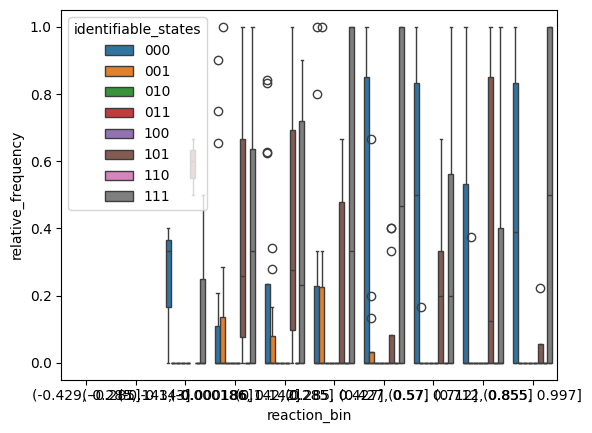

In [76]:
data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae')].dropna()
sns.boxplot(x='time_bin', y='relative_frequency', hue='identifiable_states', data=data)

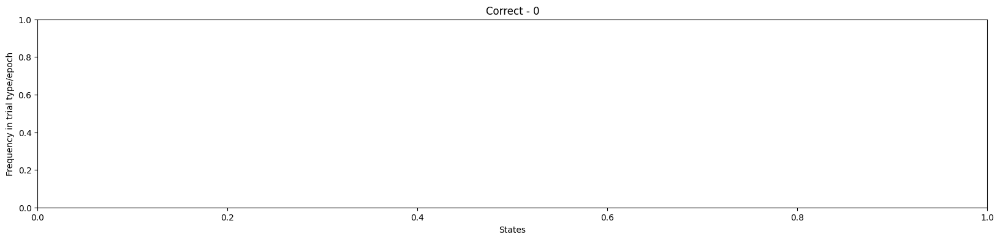

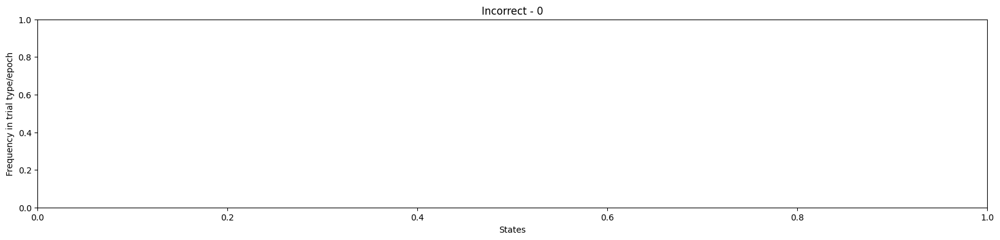

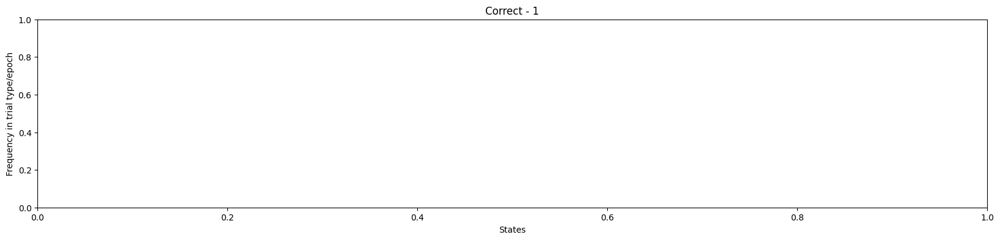

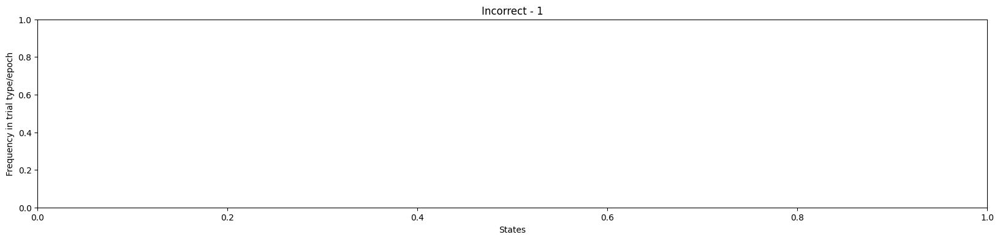

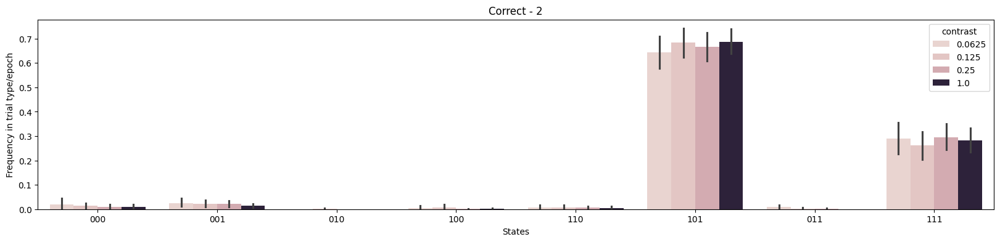

...

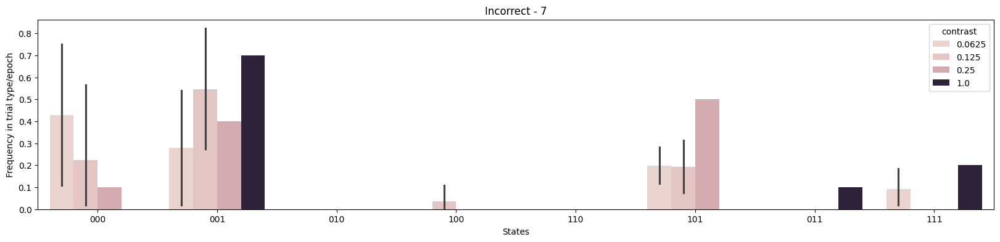

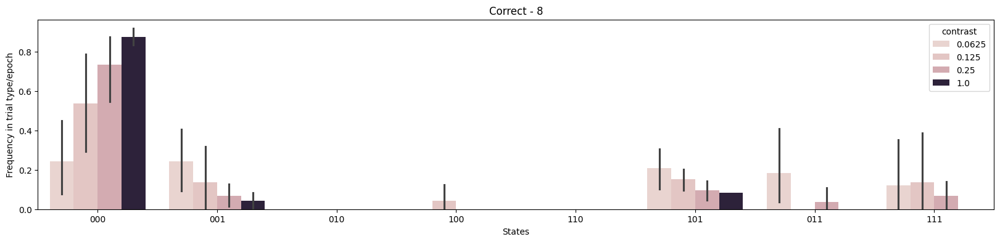

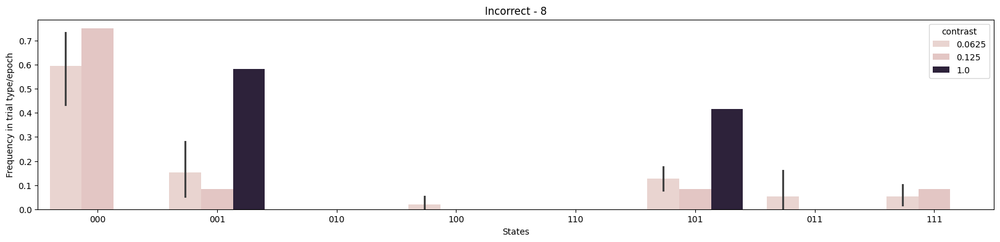

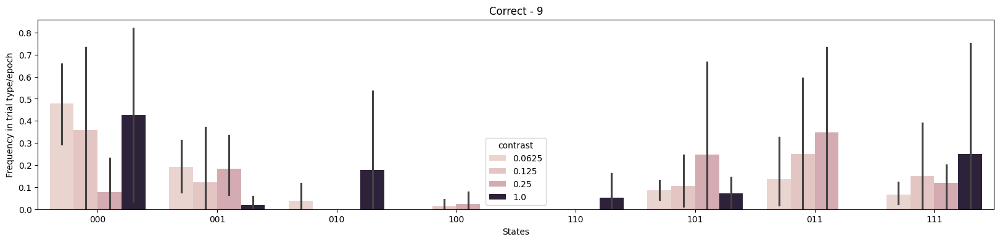

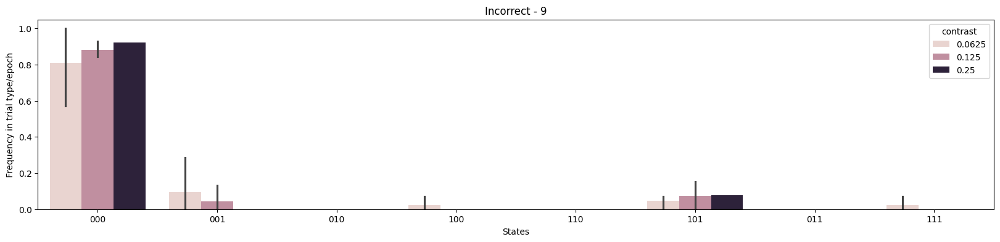

In [89]:
trial_epoch = np.unique(count['broader_label'])
epoch ='Stimulus'
reaction_bin = count.reaction_bin.unique()
use = count.dropna()
for b, bi in enumerate(reaction_bin):

    data = use.loc[(use['broader_label']==epoch) & (use['correct']==1.) & (use['reaction_bin']==bi)]
    # data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae') & (count['label']=='Quiescence')]
    plt.figure(figsize=[20, 4])
    sns.barplot(x='identifiable_states', y='relative_frequency', hue='contrast', data=data,
                order= ['000', '001', '010', '100', '110', '101', '011', '111'])
    plt.xlabel('States')
    plt.ylabel('Frequency in trial type/epoch')
    plt.title('Correct - '+str(b))
    plt.show()

    data = use.loc[(use['broader_label']==epoch) & (use['correct']==0.) & (use['reaction_bin']==bi)]
    # data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae') & (count['label']=='Quiescence')]
    plt.figure(figsize=[20, 4])
    sns.barplot(x='identifiable_states', y='relative_frequency', hue='contrast', data=data, 
                order= ['000', '001', '010', '100', '110', '101', '011', '111'])
    plt.xlabel('States')
    plt.ylabel('Frequency in trial type/epoch')
    plt.title('Incorrect - '+str(b))
    plt.show()


In [15]:
# Step 1: Group and count occurrences
count = pd.DataFrame(states_trial_type.groupby(['mouse_name', 'session', 'contrast', 'broader_label', 'correct', 'identifiable_states'])['identifiable_states'].count())  #  'correct',

# Step 2: Reset index to bring the grouping columns back into the DataFrame
count = count.reset_index(level=[0, 1, 2, 3, 4])

# Rename the count column
count.rename(columns={'identifiable_states': 'count'}, inplace=True)

# Step 3: Calculate the total counts for each group of 'mouse_name', 'session', 'label'
count['total'] = count.groupby(['mouse_name', 'session', 'contrast', 'broader_label', 'correct'])['count'].transform('sum')  # 'broader_label'

# Step 4: Compute the relative frequency
count['relative_frequency'] = count['count'] / count['total']

# Drop the 'total' column if it's no longer needed
count = count.drop(columns=['total'])

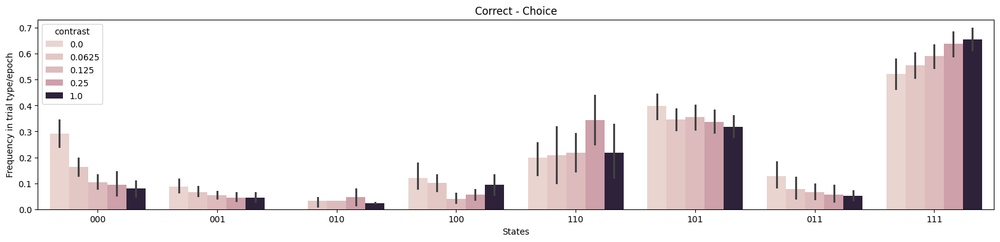

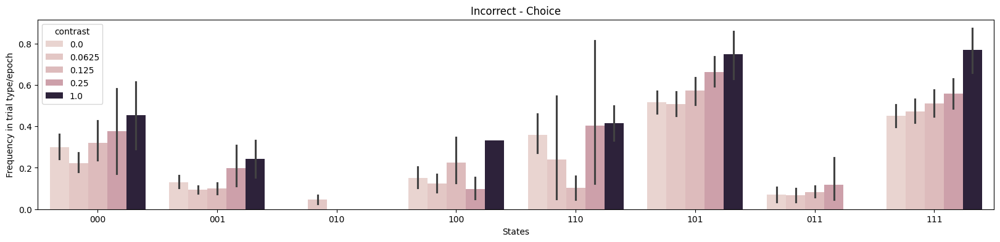

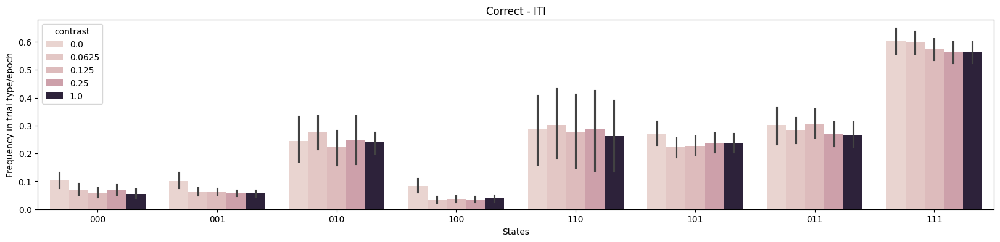

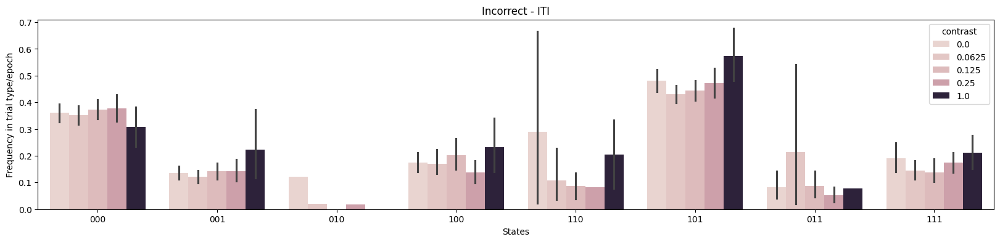

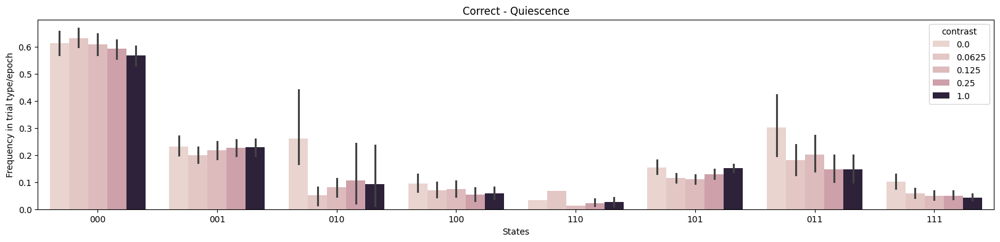

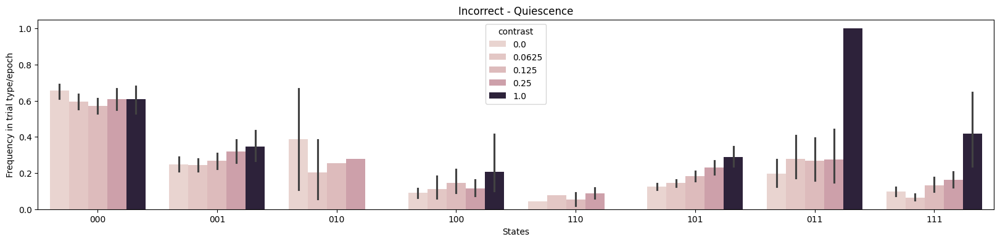

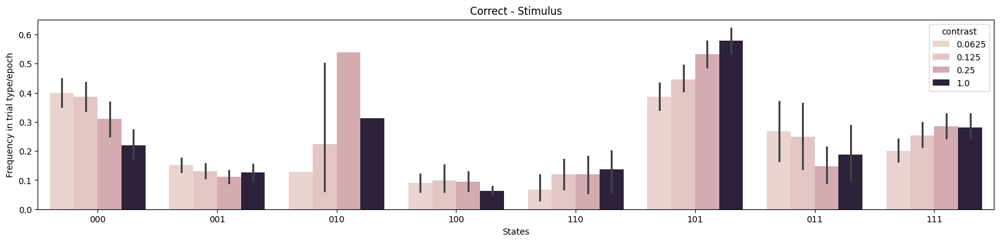

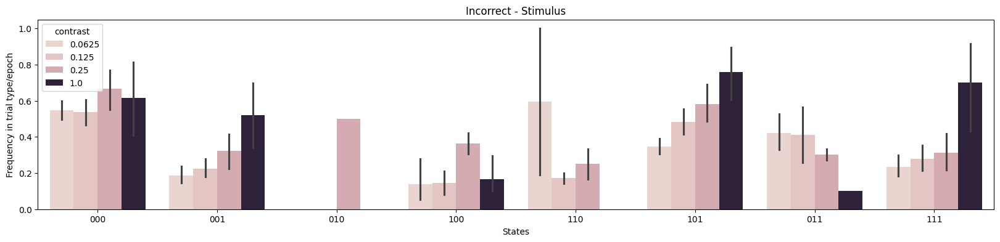

In [16]:
trial_epoch = np.unique(count['broader_label'])
epoch ='Quiescence'
contrasts = count.contrast.unique()

for epoch in trial_epoch:

    data = count.loc[(count['broader_label']==epoch) & (count['correct']==1.)]
    # data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae') & (count['label']=='Quiescence')]
    plt.figure(figsize=[20, 4])
    sns.barplot(hue='contrast', y='relative_frequency', x='identifiable_states', data=data, 
                order= ['000', '001', '010', '100', '110', '101', '011', '111'])
    plt.xlabel('States')
    plt.ylabel('Frequency in trial type/epoch')
    plt.title('Correct - '+epoch)
    plt.show()

    data = count.loc[(count['broader_label']==epoch) & (count['correct']==0.)]
    # data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae') & (count['label']=='Quiescence')]
    plt.figure(figsize=[20, 4])
    sns.barplot(hue='contrast', y='relative_frequency', x='identifiable_states', data=data, 
                order= ['000', '001', '010', '100', '110', '101', '011', '111'])
    plt.xlabel('States')
    plt.ylabel('Frequency in trial type/epoch')
    plt.title('Incorrect - '+epoch)
    plt.show()


In [ ]:
plt.figure(figsize=[20, 4])
sns.barplot(x='identifiable_states', y='relative_frequency', hue='identifiable_states', data=count, 
            palette='viridis', hue_order= ['000', '001', '010', '100', '110', '101', '011', '111'])

In [46]:
# Step 1: Group and count occurrences
count = pd.DataFrame(states_trial_type.groupby(['mouse_name', 'session', 'correct', 'broader_label', 'identifiable_states'])['identifiable_states'].count())  #  'correct',

# Step 2: Reset index to bring the grouping columns back into the DataFrame
count = count.reset_index(level=[0, 1, 2, 3])

# Rename the count column
count.rename(columns={'identifiable_states': 'count'}, inplace=True)

# Step 3: Calculate the total counts for each group of 'mouse_name', 'session', 'label'
count['total'] = count.groupby(['mouse_name', 'session', 'correct', 'broader_label'])['count'].transform('sum')  # 'broader_label'

# Step 4: Compute the relative frequency
count['relative_frequency'] = count['count'] / count['total']

# Drop the 'total' column if it's no longer needed
count = count.drop(columns=['total'])

Text(0.5, 1.0, 'Incorrect')

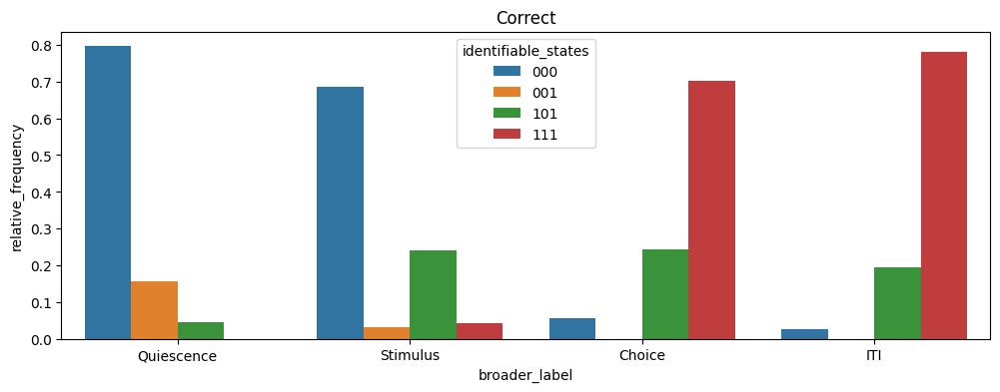

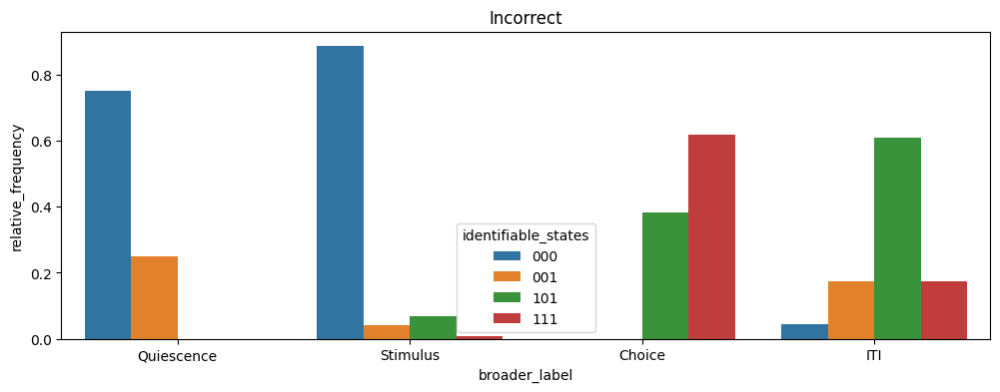

In [50]:
plt.figure(figsize=[12, 4])
data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae')
                 & (count['correct']==1.)]
sns.barplot(x='broader_label', y='relative_frequency', hue='identifiable_states', 
            data=data, order =  ['Quiescence', 'Stimulus', 'Choice', 'ITI'],
            hue_order=['000', '001', '101', '111'])
plt.title('Correct')
plt.figure(figsize=[12, 4])
data = count.loc[(count['mouse_name']=='ibl_witten_29') & (count['session']=='e9fc0a2d-c69d-44d1-9fa3-314782387cae')
                 & (count['correct']==0.)]
sns.barplot(x='broader_label', y='relative_frequency', hue='identifiable_states', 
            data=data, order =  ['Quiescence', 'Stimulus', 'Choice', 'ITI'],
            hue_order=['000', '001', '101', '111'])
plt.title('Incorrect')
# ['Quiescence', 'Stimulus right', 'Stimulus left', 'Left choice',
#                                 'Right choice', 'Correct feedback', 'Incorrect feedback',
#                                 'ITI_correct', 'ITI_incorrect']

/tmp/ipykernel_32827/986400432.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  reduced = pd.DataFrame(states_trial_type.groupby(['mouse_name', 'session', 'correct', 'contrast'])['reaction', 'response', 'elongation'].mean())


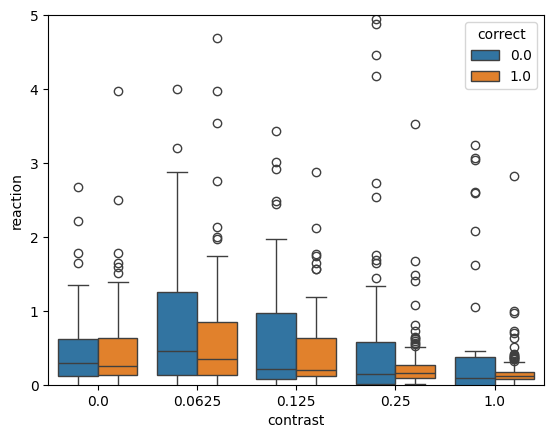

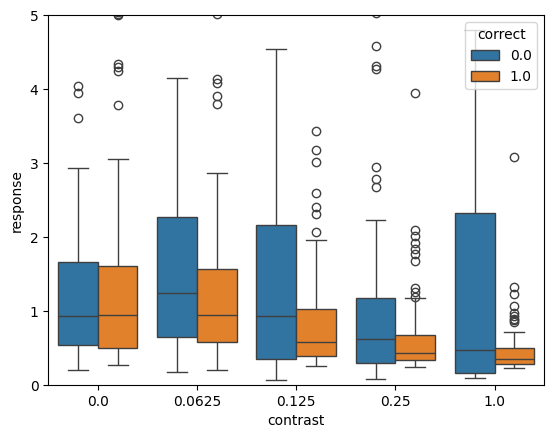

(0.0, 5.0)

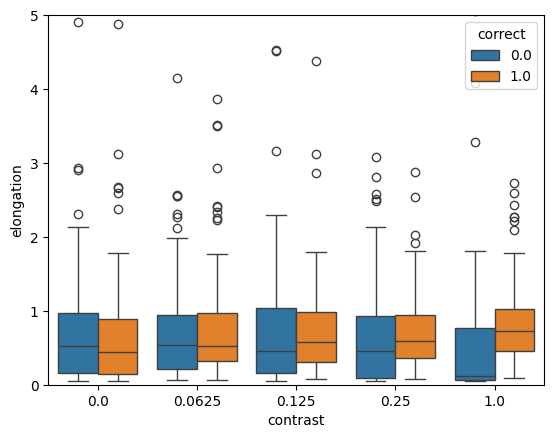

In [10]:
# Plot across sessions
reduced = pd.DataFrame(states_trial_type.groupby(['mouse_name', 'session', 'correct', 'contrast'])['reaction', 'response', 'elongation'].mean())
reduced = reduced.reset_index(level=[0, 1, 2, 3])

sns.boxplot(x='contrast', y='reaction', hue='correct', data=reduced)
plt.ylim([0, 5])
plt.show()
sns.boxplot(x='contrast', y='response', hue='correct', data=reduced)
plt.ylim([0, 5])
plt.show()
sns.boxplot(x='contrast', y='elongation', hue='correct', data=reduced)
plt.ylim([0, 5])